In [1]:
import argparse
import os

import torch
import torch_geometric as pyg
from tqdm.notebook import tqdm

import dataset
import model
import rollout
import visualize

In [2]:
# sample config
config = {
    "data_path": "datasets/WaterDropSample",
    "epoch": 1,                             
    "batch_size": 2,                        
    "lr": 1e-3,                             
    "num_workers": 0,                       
    "noise": 3e-4,                  
    "eval_interval": 100,            
    "rollout_interval": 100,  
    "vis_interval": 1000000,             
    "save_interval": 1000000,            
    "output_path": "output",      
}

In [3]:
# load onestep datasets
train_dataset = dataset.OneStepDataset(
    config["data_path"], "train", noise_std=config["noise"]
)
valid_dataset = dataset.OneStepDataset(
    config["data_path"], "valid", noise_std=config["noise"]
)
print(train_dataset[0])
print(valid_dataset[0])

Data(x=[678], edge_index=[2, 4370], edge_attr=[4370, 3], y=[678, 2], pos=[678, 14])
Data(x=[482], edge_index=[2, 3096], edge_attr=[3096, 3], y=[482, 2], pos=[482, 14])


In [4]:
# setup dataloaders
train_loader = pyg.loader.DataLoader(
    train_dataset,
    batch_size=config["batch_size"],
    shuffle=True,
    pin_memory=False, # only beneficial when training on GPU
    num_workers=config["num_workers"],
)
valid_loader = pyg.loader.DataLoader(
    valid_dataset,
    batch_size=config["batch_size"],
    shuffle=False,
    pin_memory=False, # only beneficial when training on GPU
    num_workers=config["num_workers"],
)
for x in train_loader:
    print(x)
    break
for x in valid_loader:
    print(x)
    break

DataBatch(x=[1033], edge_index=[2, 8351], edge_attr=[8351, 3], y=[1033, 2], pos=[1033, 14], batch=[1033], ptr=[3])
DataBatch(x=[964], edge_index=[2, 6240], edge_attr=[6240, 3], y=[964, 2], pos=[964, 14], batch=[964], ptr=[3])


In [5]:
# load rollout dataset
rollout_dataset = dataset.RolloutDataset(config["data_path"], "valid")
rollout_dataset[0].keys()
for k,v in rollout_dataset[0].items():
    print(k, v.shape, v.dtype)

particle_type torch.Size([482]) torch.int64
position torch.Size([1001, 482, 2]) torch.float32


In [6]:
# visualize example rollout

%matplotlib inline
import matplotlib.pyplot as plt
from visualize import visualize_single
from IPython.display import HTML

plt.ioff()
ani = visualize_single(rollout_dataset[0]["particle_type"], rollout_dataset[0]["position"], rollout_dataset.metadata)
HTML(ani.to_jshtml())

In [7]:
# init model
simulator = model.LearnedSimulator(   
    hidden_size=32,
    n_mp_layers=2
)
simulator

LearnedSimulator(
  (embed_type): Embedding(9, 16)
  (node_in): MLP(
    (layers): ModuleList(
      (0): Linear(in_features=30, out_features=32, bias=True)
      (1): ReLU()
      (2): Linear(in_features=32, out_features=32, bias=True)
      (3): ReLU()
      (4): Linear(in_features=32, out_features=32, bias=True)
      (5): LayerNorm((32,), eps=1e-05, elementwise_affine=True)
    )
  )
  (edge_in): MLP(
    (layers): ModuleList(
      (0): Linear(in_features=3, out_features=32, bias=True)
      (1): ReLU()
      (2): Linear(in_features=32, out_features=32, bias=True)
      (3): ReLU()
      (4): Linear(in_features=32, out_features=32, bias=True)
      (5): LayerNorm((32,), eps=1e-05, elementwise_affine=True)
    )
  )
  (node_out): MLP(
    (layers): ModuleList(
      (0): Linear(in_features=32, out_features=32, bias=True)
      (1): ReLU()
      (2): Linear(in_features=32, out_features=32, bias=True)
      (3): ReLU()
      (4): Linear(in_features=32, out_features=2, bias=True)
    

In [9]:
from train import train

# train loop
train_loss_list, eval_loss_list, onestep_mse_list, rollout_mse_list = train(config, simulator, train_loader, valid_loader, rollout_dataset, rollout_dataset.metadata)

Epoch 0:  10%|███▌                                | 98/995 [00:24<00:44, 19.96it/s, loss=0.929, avg_loss=0.991, lr=0.001]


Eval: Loss: 0.9552946877838978, One Step MSE: 1.8347532441728973e-07


Epoch 0:  10%|███▌                               | 101/995 [00:38<46:07,  3.10s/it, loss=0.974, avg_loss=0.991, lr=0.001]


Eval: Rollout MSE: 0.4601166546344757


Epoch 0:  20%|███████                            | 199/995 [01:05<00:41, 19.15it/s, loss=0.958, avg_loss=0.999, lr=0.001]


Eval: Loss: 0.9546074500036, One Step MSE: 1.8332992373640293e-07


Epoch 0:  20%|███████                            | 201/995 [01:22<50:29,  3.81s/it, loss=0.931, avg_loss=0.999, lr=0.001]


Eval: Rollout MSE: 0.42334210872650146


Epoch 0:  30%|██████████▊                         | 299/995 [01:47<00:55, 12.49it/s, loss=0.97, avg_loss=0.987, lr=0.001]


Eval: Loss: 0.9523246766334802, One Step MSE: 1.8290885014120428e-07


Epoch 0:  30%|█████████▉                       | 300/995 [02:09<1:11:45,  6.20s/it, loss=0.961, avg_loss=0.987, lr=0.001]


Eval: Rollout MSE: 0.16205434501171112


Epoch 0:  40%|█████████████▉                     | 397/995 [02:32<00:34, 17.40it/s, loss=0.922, avg_loss=0.995, lr=0.001]


Eval: Loss: 0.9502528441012206, One Step MSE: 1.8249904601087557e-07


Epoch 0:  40%|██████████████▏                    | 402/995 [02:50<27:20,  2.77s/it, loss=0.904, avg_loss=0.995, lr=0.001]


Eval: Rollout MSE: 0.15083441138267517


Epoch 0:  50%|█████████████████▉                  | 497/995 [03:12<00:24, 20.42it/s, loss=0.92, avg_loss=0.999, lr=0.001]


Eval: Loss: 0.9497955245588293, One Step MSE: 1.8241257353122422e-07


Epoch 0:  50%|██████████████████▏                 | 501/995 [03:28<25:14,  3.07s/it, loss=1.07, avg_loss=0.999, lr=0.001]


Eval: Rollout MSE: 0.11446777731180191


Epoch 0:  60%|█████████████████████▋              | 598/995 [03:52<00:20, 19.12it/s, loss=1.01, avg_loss=0.996, lr=0.001]


Eval: Loss: 0.949181195239925, One Step MSE: 1.8229288311440586e-07


Epoch 0:  60%|█████████████████████▏             | 601/995 [04:10<26:20,  4.01s/it, loss=0.936, avg_loss=0.996, lr=0.001]


Eval: Rollout MSE: 0.08815517649054527


Epoch 0:  70%|████████████████████████▌          | 698/995 [04:38<00:18, 16.18it/s, loss=0.937, avg_loss=0.997, lr=0.001]


Eval: Loss: 0.9483505914558717, One Step MSE: 1.8212653116331957e-07


Epoch 0:  71%|████████████████████████▋          | 702/995 [04:54<17:06,  3.50s/it, loss=0.922, avg_loss=0.997, lr=0.001]


Eval: Rollout MSE: 0.08198215067386627


Epoch 0:  80%|████████████████████████████       | 799/995 [05:24<00:10, 19.33it/s, loss=0.967, avg_loss=0.998, lr=0.001]


Eval: Loss: 0.9468713118203321, One Step MSE: 1.818427816561236e-07


Epoch 0:  81%|████████████████████████████▏      | 802/995 [05:41<13:16,  4.13s/it, loss=0.918, avg_loss=0.998, lr=0.001]


Eval: Rollout MSE: 0.15910861641168594


Epoch 0:  90%|███████████████████████████████▌   | 899/995 [06:05<00:05, 16.78it/s, loss=0.968, avg_loss=0.996, lr=0.001]


Eval: Loss: 0.9520457516962559, One Step MSE: 1.8283819272895488e-07


Epoch 0:  91%|████████████████████████████████▌   | 901/995 [06:20<05:48,  3.71s/it, loss=3.53, avg_loss=0.999, lr=0.001]


Eval: Rollout MSE: 0.12660153582692146


Epoch 0: 100%|███████████████████████████████████████| 995/995 [06:25<00:00,  2.58it/s, loss=0.954, avg_loss=1, lr=0.001]


<Figure size 640x480 with 0 Axes>

<Figure size 1000x500 with 0 Axes>

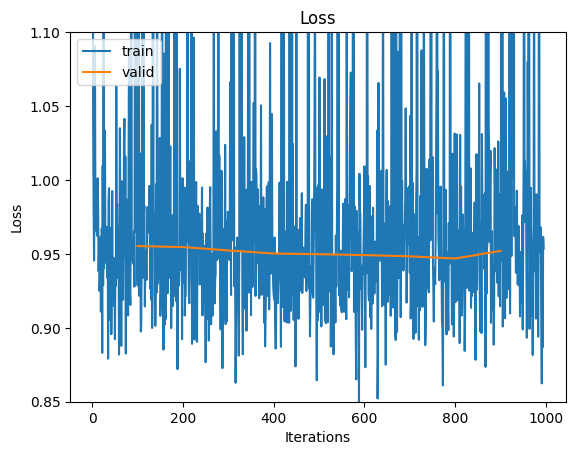

In [40]:
# plot loss
plt.clf()
plt.figure()
plt.plot(*zip(*train_loss_list), label="train")
plt.plot(*zip(*eval_loss_list), label="valid")
plt.ylim(bottom=0.85, top=1.1)
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('Loss')
plt.legend()
plt.show()

<Figure size 640x480 with 0 Axes>

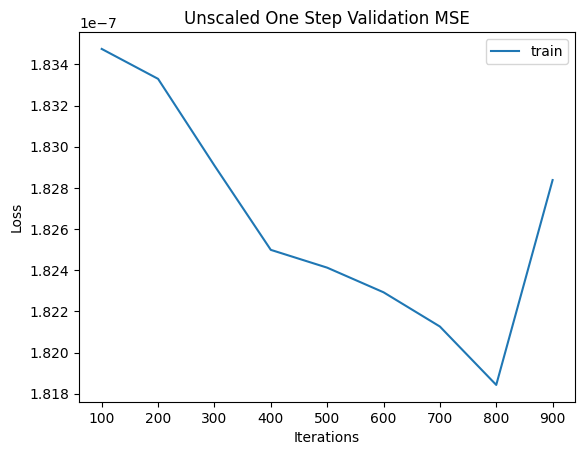

In [41]:
# plot oneStepMSE
plt.clf()
plt.figure()
plt.plot(*zip(*onestep_mse_list), label="train")
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('Unscaled One Step Validation MSE')
plt.legend()
plt.show()

<Figure size 640x480 with 0 Axes>

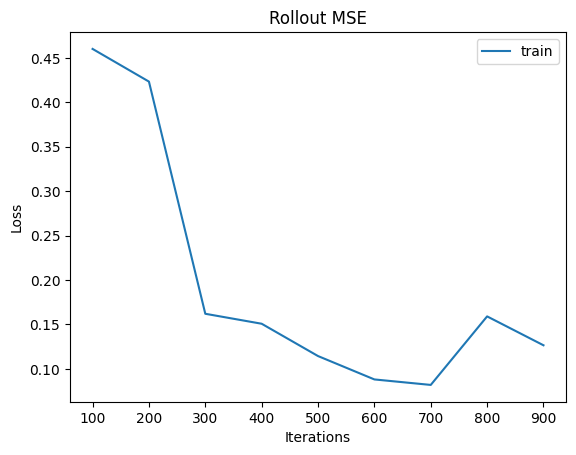

In [42]:
# plot rolloutMSE
plt.clf()
plt.figure()
plt.plot(*zip(*rollout_mse_list), label="train")
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('Rollout MSE')
plt.legend()
plt.show()

In [39]:
# visualize rollout
from visualize import visualize_pair

simulator.eval()
rollout_data = rollout_dataset[0]
rollout_out = rollout.rollout(simulator, rollout_data, rollout_dataset.metadata, config["noise"])
rollout_out = rollout_out.permute(1, 0, 2)
plt.clf()
ani = visualize.visualize_pair(rollout_data["particle_type"], rollout_out, rollout_data["position"], rollout_dataset.metadata)
HTML(ani.to_jshtml())

Animation size has reached 20993671 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
